<a href="https://colab.research.google.com/github/DiogoCarapito/data_mining_project_20210949_20221202/blob/main/MDDM_Project_20210949_20221202_V1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Install updated version of pandas_profiling.
!pip install pandas_profiling==3.3.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#1
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
import requests
#import openpyxl

from sklearn.impute import KNNImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder

from itertools import product
from pandas_profiling import ProfileReport


from os.path import join
from datetime import datetime

from scipy.cluster.hierarchy import dendrogram
from collections import Counter

from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering
from sklearn.base import clone
from sklearn.metrics import pairwise_distances

from sklearn.manifold import TSNE
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
import graphviz

sns.set()

In [ ]:
#2.1
# FILIPA

from google.colab import drive
drive.mount('/content/drive')
!ls "/content/drive/My Drive/Colab Notebooks"

myfile = '/content/drive/My Drive/ColabNotebooks/WonderfulWinesWorld_Clustering_DMDM2022e23.xlsx'
#myfile = '/content/drive/My Drive/Colab Notebooks/WonderfulWinesWorld_Clustering_DMDM2022e23.xlsx'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
'DV practical - Lesson 1.ipynb'   Untitled   Untitled0.ipynb


In [ ]:
#2.2
# DIOGO
#myfile = 'WonderfulWinesWorld_Clustering_DMDM2022e23.xlsx'

In [ ]:
#3
df = pd.read_excel(myfile)
df_original = df.copy()
df.head(10)

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,Freq,Recency,Monetary,...,Perdeal,Dryred,Sweetred,Drywh,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access
0,1001,789,68,16,90782,0,0,29,66,1402,...,3,37,5,44,10,3,2,19,4,1
1,1002,623,78,20,113023,0,0,31,6,1537,...,1,55,1,38,4,2,2,9,1,0
2,1003,583,24,18,28344,1,0,4,69,44,...,66,32,19,24,1,24,63,59,7,1
3,1004,893,59,19,93571,0,1,21,10,888,...,12,60,10,19,6,5,15,35,5,0
4,1005,1062,59,18,91852,0,1,25,26,1138,...,5,59,5,28,4,4,19,34,6,0
5,1006,792,32,20,22386,1,1,5,65,56,...,96,47,2,48,2,1,29,67,9,1
6,1007,1120,45,17,69485,1,1,11,73,345,...,61,71,7,13,1,8,3,46,7,0
7,1008,658,54,18,68602,0,1,2,44,41,...,15,84,1,12,2,0,3,37,3,0
8,1009,792,74,18,109499,0,0,29,75,1401,...,3,38,9,35,9,9,9,17,1,1
9,1010,1109,20,14,23846,1,0,1,153,19,...,55,18,55,17,10,1,6,39,7,0


In [ ]:
## Verificar se há dados em formato character
df.dtypes
## é tudo int64 =)

Custid         int64
Dayswus        int64
Age            int64
Educ           int64
Income         int64
Kidhome        int64
Teenhome       int64
Freq           int64
Recency        int64
Monetary       int64
LTV            int64
Perdeal        int64
Dryred         int64
Sweetred       int64
Drywh          int64
Sweetwh        int64
Dessert        int64
Exotic         int64
WebPurchase    int64
WebVisit       int64
Access         int64
dtype: object

In [ ]:
## Ver se há NAN

df.isna().sum()

## não há!

Custid         0
Dayswus        0
Age            0
Educ           0
Income         0
Kidhome        0
Teenhome       0
Freq           0
Recency        0
Monetary       0
LTV            0
Perdeal        0
Dryred         0
Sweetred       0
Drywh          0
Sweetwh        0
Dessert        0
Exotic         0
WebPurchase    0
WebVisit       0
Access         0
dtype: int64

In [ ]:
## também não parece existir duplicados

df.duplicated().sum()

0

'''
Variables in the customer table

CUSTID - customer ID number
DAYSWUS - number of days as a customer
AGE - customer's age
EDUCATION - years of education
INCOME - household income
KIDHOME - 1=has child under 13 yo living at home
TEENHOME - 1=has teen (13 to 19 yo) living at home
FREQ - number of purchases in past 18 months
RECENCY - number of days since last purchase
MONETARY - total sales to this person in past 18 months
LTV - customer lifetime value
PERDEAL - % purchases bought on discount (units)
DRYRED - %of wines that were dry red wines
SWEETRED - %of wines that were sweet red wines
DRYWH - %of wines that were dry white wines
SWEETWH - %of wines that were sweet white wines
DESSERT - %of wines that were dessert wines (port, sherry, etc.)
EXOTIC - %of wines that were exotic wines
WEBPURCH - %of purchases made on website/app
WEBVISIT - average number of visits to website/app per month
ACCESS - number of accessories bought in past 18 months
'''

'''Proposta de novas variaveis:
KID_OR_TEEN = 0 if KIDHOME and TEENHOME == 0 else 1
    não sei se há grande diferença entre ter crianças ou adolescentes na analise, se calhar ter ou não ter é mais deterimental
    assim reduz-se o numero de variáveis
    ou então nem sequer entra nos algoritmis de clustering e aparece só no fim
AVERAGE_SPENT_LAST_18_MTH = MONETARY / FREQUENCY
    este faz me confusão
    estão tão correlacionados
    para reduzir o espaço, mas fico um pouco na duvida

Gestão de outliers:
REVENCY = se (REVENCY)>100 então 100
    para simplificar - se não vem a mais de 100 dias, então já é cliente antigo
    para resolver a questão da escaces de clientes acima de 100 dias de ultima compra
'''

In [ ]:
## Analise descritiva para estudar dados

df.describe().T

,count,mean,std,min,25%,50%,75%,max
Custid,10000.0,6000.5000,2886.895680,1001.0,3500.75,6000.5,8500.25,11000.0
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Educ,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Recency,10000.0,62.4068,69.874255,0.0,26.00,52.0,78.25,549.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0


### LTV (customer lifetime value) = * valor médio de compra * periodo de retenção * margem de lucro

In [ ]:
## Check descriptive statistics: All features
df.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Custid,10000.0,6000.5000,2886.895680,1001.0,3500.75,6000.5,8500.25,11000.0
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Educ,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Recency,10000.0,62.4068,69.874255,0.0,26.00,52.0,78.25,549.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0


In [ ]:
# Using the pandas function of profilling to get more knowledge about dataset
profile = ProfileReport(
    df, 
    title='WWW Customer Data',
    correlations={
      "pearson": {"calculate": True},
      "spearman": {"calculate": True},
      "kendall": {"calculate": False},
      "phi_k": {"calculate": False},
      "cramers": {"calculate": False},
    },
)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
## Define a function that plots multiple histograms

def plot_multiple_histograms(data, feats, title="Numeric Variables' Histograms"):

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      ax.hist(data[feat])
      ax.set_title(feat)

    # Layout
    # Add a centered title to the figure:
    plt.suptitle(title)

    plt.show()

    return


## Define a function that plots multiple box plots

def plot_multiple_boxplots(data, feats, title="Numeric Variables' Box Plots"):

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(feats) / 2), figsize=(20, 11))

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), feats): # Notice the zip() function and flatten() method
      sns.boxplot(x=data[feat], ax=ax)
      ax.set_title(feat)

    # Layout
    # Add a centered title to the figure:
    plt.suptitle(title)

    plt.show()

    return

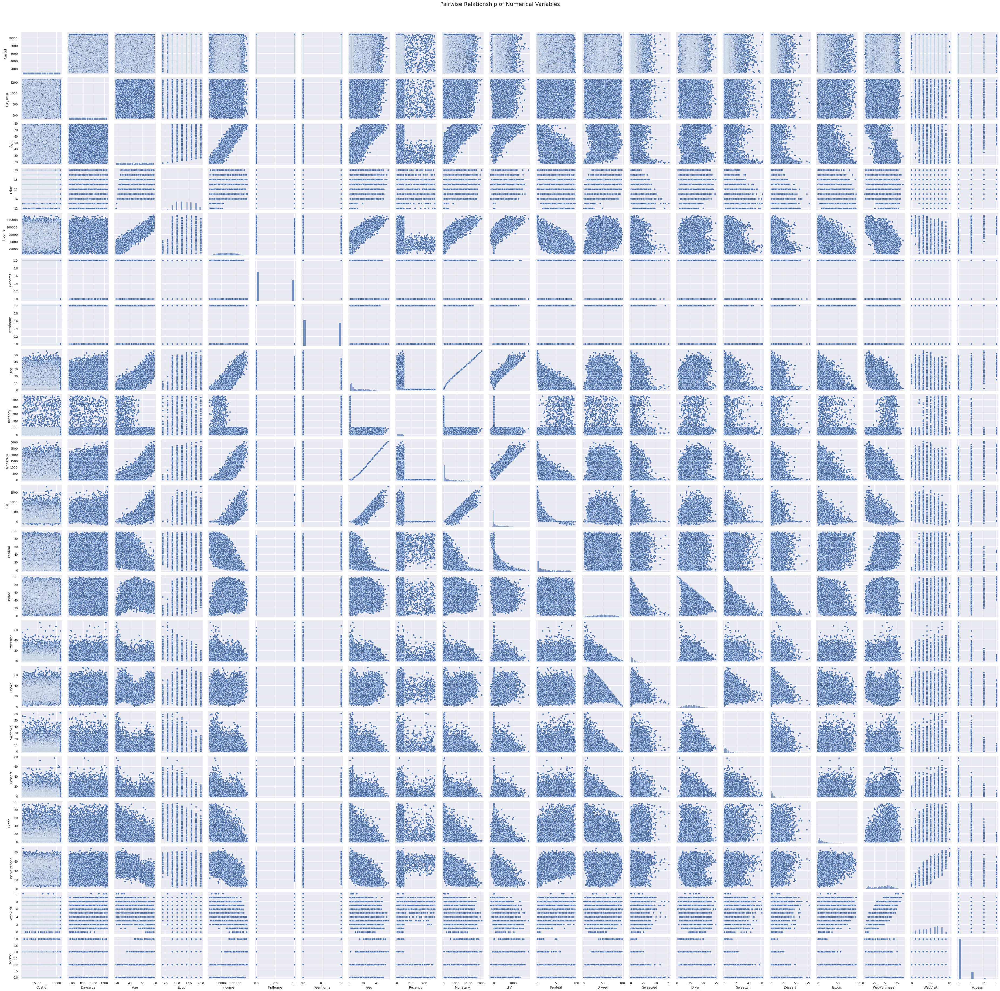

In [ ]:
# Pairwise Relationship of All Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df, diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

In [ ]:
# No need to fell missing values

## OUTLIER REMOVAL

In [ ]:
# filtrar por recency igual ou inferior a 100 e ver qual
# a % de dados restantes após filtro
filters1 = (
    (df['Recency']<=100)
)

df_1 = df[filters1]
print('Percentage of data kept after removing outliers:', np.round(df_1.shape[0] / df.shape[0], 4))

Percentage of data kept after removing outliers: 0.9553


In [ ]:
# Caracterizar os outliers
df_2 = df[df['Recency']>100]
df_2.describe(include="all").T

# 447 clientes não veem a mais de 100 dias
# todos abaixo dos 55 anos
# menor income
# frequencia de 1 em todos!
# só vieram uma vez e foi a mais de 100 dias!

,count,mean,std,min,25%,50%,75%,max
Custid,447.0,6049.069351,2939.066553,1010.0,3231.0,6118.0,8696.5,10956.0
Dayswus,447.0,857.525727,195.817840,550.0,685.0,837.0,1006.0,1249.0
Age,447.0,30.814318,8.647764,18.0,24.0,30.0,37.0,54.0
Educ,447.0,16.326622,2.000176,12.0,15.0,16.0,18.0,20.0
Income,447.0,41479.829978,13584.639674,10000.0,31746.0,40697.0,50904.0,80242.0
Kidhome,447.0,0.774049,0.418675,0.0,1.0,1.0,1.0,1.0
Teenhome,447.0,0.402685,0.490988,0.0,0.0,0.0,1.0,1.0
Freq,447.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
Recency,447.0,327.921700,132.411272,101.0,208.0,338.0,440.0,549.0
Monetary,447.0,16.154362,3.668539,7.0,13.0,18.0,19.0,20.0


In [ ]:
# filtro para ver quantos é que só tinha 1 vinda
df_3 = df[df['Freq']==1]
df_3.describe(include="all").T

# 541 só foram uma vez à loja
# portanto há 541 menos 447 clientes, portanto 94 clientes que
# só foram uma vez à loja e há menso de 100 dias

,count,mean,std,min,25%,50%,75%,max
Custid,541.0,6070.674677,2889.139031,1010.0,3506.0,6119.0,8567.0,10956.0
Dayswus,541.0,857.116451,193.815030,550.0,687.0,837.0,1007.0,1249.0
Age,541.0,30.780037,8.698108,18.0,24.0,30.0,37.0,57.0
Educ,541.0,16.349353,2.017044,12.0,15.0,16.0,18.0,20.0
Income,541.0,41750.652495,13606.624473,10000.0,32203.0,41722.0,51395.0,80265.0
Kidhome,541.0,0.778189,0.415849,0.0,1.0,1.0,1.0,1.0
Teenhome,541.0,0.408503,0.492012,0.0,0.0,0.0,1.0,1.0
Freq,541.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
Recency,541.0,279.101664,161.151122,0.0,143.0,278.0,426.0,549.0
Monetary,541.0,16.231054,3.632701,6.0,13.0,18.0,19.0,20.0


## Treat Outliers

In [ ]:
# Rencency aparece ter outliers acima dos 100

df['New_Recency'] = [row if row < 101 else 101 for index, row in df['Recency'].iteritems()]
df.drop(columns='Recency', inplace=True)
df.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Custid,10000.0,6000.5000,2886.895680,1001.0,3500.75,6000.5,8500.25,11000.0
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Educ,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0
LTV,10000.0,209.0712,291.986040,-178.0,-2.00,57.0,364.00,1791.0


## Feature Engineering

In [ ]:
# criação de uma nova variavel booleana que traduz se existem
# menores <19 (kid + teen) em casa

df['kids_teens'] = df['Kidhome']
df['kids_teens'] = [1 if row == 1 else df['kids_teens'][index] for index, row in df['Teenhome'].iteritems()]

df.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Custid,10000.0,6000.5000,2886.895680,1001.0,3500.75,6000.5,8500.25,11000.0
Dayswus,10000.0,898.1020,202.492789,550.0,723.75,894.0,1074.00,1250.0
Age,10000.0,47.9273,17.302721,18.0,33.00,48.0,63.00,78.0
Educ,10000.0,16.7391,1.876375,12.0,15.00,17.0,18.00,20.0
Income,10000.0,69904.3580,27612.233311,10000.0,47642.00,70012.0,92147.00,140628.0
Kidhome,10000.0,0.4188,0.493387,0.0,0.00,0.0,1.00,1.0
Teenhome,10000.0,0.4698,0.499112,0.0,0.00,0.0,1.00,1.0
Freq,10000.0,14.6281,11.969073,1.0,4.00,12.0,24.00,56.0
Monetary,10000.0,622.5552,647.135323,6.0,63.00,383.0,1077.00,3052.0
LTV,10000.0,209.0712,291.986040,-178.0,-2.00,57.0,364.00,1791.0


## Feature engeneering

In [ ]:
# Cálculo de gásto médio por compra spent por visita à loja
# criação de uma nova variável com informação
# e acaba por servir também como redução do espaço

df['average_spent'] = [df['Monetary'][index] / df['Freq'][index] for index, row in df.iterrows()]
#df[['Monetary', 'Freq','average_spent']].describe(include="all").T


In [ ]:
# Calculo de numero de compras online por visita ao site, dado que são
# vairaves bastante correlacionadas

df['Web_eficacy'] = df['WebPurchase'] * df['WebVisit']
df[['Web_eficacy', 'WebPurchase','WebVisit']].describe(include="all").T



,count,mean,std,min,25%,50%,75%,max
Web_eficacy,10000.0,259.0999,180.933193,0.0,93.0,246.0,400.0,880.0
WebPurchase,10000.0,42.3762,18.522062,4.0,28.0,45.0,57.0,88.0
WebVisit,10000.0,5.2166,2.330457,0.0,3.0,6.0,7.0,10.0


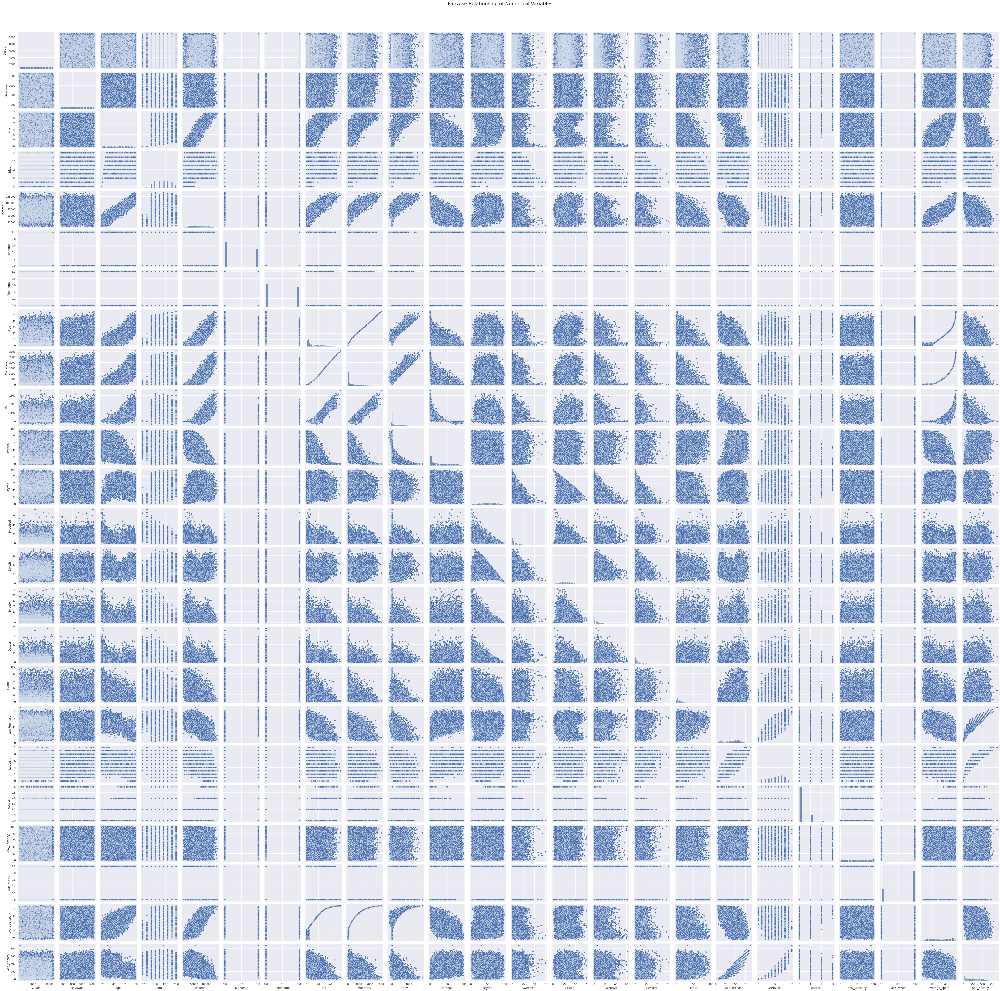

In [ ]:
# Pairwise Relationship of All Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df, diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

In [ ]:
df.head(10)

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,Freq,Monetary,LTV,...,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,New_Recency,kids_teens,average_spent,Web_eficacy
0,1001,789,68,16,90782,0,0,29,1402,699,...,10,3,2,19,4,1,66,0,48.344828,76
1,1002,623,78,20,113023,0,0,31,1537,565,...,4,2,2,9,1,0,6,0,49.580645,9
2,1003,583,24,18,28344,1,0,4,44,-3,...,1,24,63,59,7,1,69,1,11.000000,413
3,1004,893,59,19,93571,0,1,21,888,207,...,6,5,15,35,5,0,10,1,42.285714,175
4,1005,1062,59,18,91852,0,1,25,1138,355,...,4,4,19,34,6,0,26,1,45.520000,204
5,1006,792,32,20,22386,1,1,5,56,-18,...,2,1,29,67,9,1,65,1,11.200000,603
6,1007,1120,45,17,69485,1,1,11,345,-45,...,1,8,3,46,7,0,73,1,31.363636,322
7,1008,658,54,18,68602,0,1,2,41,9,...,2,0,3,37,3,0,44,1,20.500000,111
8,1009,792,74,18,109499,0,0,29,1401,613,...,9,9,9,17,1,1,75,0,48.310345,17
9,1010,1109,20,14,23846,1,0,1,19,-1,...,10,1,6,39,7,0,101,1,19.000000,273


## Redundancy

In [ ]:
df_after_fe = df.copy()
df.drop(columns = ['Freq', 'Monetary',], inplace=True)
df.head(10)

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,LTV,Perdeal,Dryred,...,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,New_Recency,kids_teens,average_spent,Web_eficacy
0,1001,789,68,16,90782,0,0,699,3,37,...,10,3,2,19,4,1,66,0,48.344828,76
1,1002,623,78,20,113023,0,0,565,1,55,...,4,2,2,9,1,0,6,0,49.580645,9
2,1003,583,24,18,28344,1,0,-3,66,32,...,1,24,63,59,7,1,69,1,11.000000,413
3,1004,893,59,19,93571,0,1,207,12,60,...,6,5,15,35,5,0,10,1,42.285714,175
4,1005,1062,59,18,91852,0,1,355,5,59,...,4,4,19,34,6,0,26,1,45.520000,204
5,1006,792,32,20,22386,1,1,-18,96,47,...,2,1,29,67,9,1,65,1,11.200000,603
6,1007,1120,45,17,69485,1,1,-45,61,71,...,1,8,3,46,7,0,73,1,31.363636,322
7,1008,658,54,18,68602,0,1,9,15,84,...,2,0,3,37,3,0,44,1,20.500000,111
8,1009,792,74,18,109499,0,0,613,3,38,...,9,9,9,17,1,1,75,0,48.310345,17
9,1010,1109,20,14,23846,1,0,-1,55,18,...,10,1,6,39,7,0,101,1,19.000000,273


## Relevância

In [ ]:
df.columns

Index(['Custid', 'Dayswus', 'Age', 'Educ', 'Income', 'Kidhome', 'Teenhome',
       'LTV', 'Perdeal', 'Dryred', 'Sweetred', 'Drywh', 'Sweetwh', 'Dessert',
       'Exotic', 'WebPurchase', 'WebVisit', 'Access', 'New_Recency',
       'kids_teens', 'average_spent', 'Web_eficacy'],
      dtype='object')

In [ ]:
# criação de lista de métricas numéricas e não numéricas

non_metric_features = ['Educ', 'Kidhome', 'Teenhome', 'kids_teens']
metric_features = df.columns.drop(non_metric_features).to_list()
metric_features

['Custid',
 'Dayswus',
 'Age',
 'Income',
 'LTV',
 'Perdeal',
 'Dryred',
 'Sweetred',
 'Drywh',
 'Sweetwh',
 'Dessert',
 'Exotic',
 'WebPurchase',
 'WebVisit',
 'Access',
 'New_Recency',
 'average_spent',
 'Web_eficacy']

In [ ]:
# Divisão de variaves para 2 segmentos: Custumer Analysis e Buying Behaviour
costumer_analysis = [
    'Dayswus',
    'Age',
    'Income',
    'LTV',
    'Perdeal',
    'WebPurchase',
    'WebVisit',
    'Access',
    'New_Recency',
    'average_spent'
]
buying_behaviour = [
    'Dryred',
    'Sweetred',
    'Drywh',
    'Sweetwh',
    'Dessert',
    'Exotic'
]

print(costumer_analysis)
print(buying_behaviour)

['Dayswus', 'Age', 'Income', 'LTV', 'Perdeal', 'WebPurchase', 'WebVisit', 'Access', 'New_Recency', 'average_spent']
['Dryred', 'Sweetred', 'Drywh', 'Sweetwh', 'Dessert', 'Exotic']


## Normalização de dados

In [ ]:
df_standard = df.copy()

#sscaler = StandardScaler()
sscaler = MinMaxScaler()
#sscaled_feat = sscaler.fit_transform(df_standard[metric_features])
sscaled_feat = sscaler.fit_transform(df_standard[metric_features])

df_standard[metric_features] = sscaled_feat
df_standard.head(10)

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,LTV,Perdeal,Dryred,...,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,New_Recency,kids_teens,average_spent,Web_eficacy
0,0.0000,0.341429,0.833333,16,0.618413,0,0,0.445404,0.030928,0.367347,...,0.161290,0.038961,0.020833,0.178571,0.4,0.333333,0.653465,0,0.873089,0.086364
1,0.0001,0.104286,1.000000,20,0.788675,0,0,0.377349,0.010309,0.551020,...,0.064516,0.025974,0.020833,0.059524,0.1,0.000000,0.059406,0,0.898570,0.010227
2,0.0002,0.047143,0.100000,18,0.140429,1,0,0.088878,0.680412,0.316327,...,0.016129,0.311688,0.656250,0.654762,0.7,0.333333,0.683168,1,0.103093,0.469318
3,0.0003,0.490000,0.683333,19,0.639763,0,1,0.195531,0.123711,0.602041,...,0.096774,0.064935,0.156250,0.369048,0.5,0.000000,0.099010,1,0.748159,0.198864
4,0.0004,0.731429,0.683333,18,0.626604,0,1,0.270696,0.051546,0.591837,...,0.064516,0.051948,0.197917,0.357143,0.6,0.000000,0.257426,1,0.814845,0.231818
5,0.0005,0.345714,0.233333,20,0.094819,1,1,0.081260,0.989691,0.469388,...,0.032258,0.012987,0.302083,0.750000,0.9,0.333333,0.643564,1,0.107216,0.685227
6,0.0006,0.814286,0.450000,17,0.455377,1,1,0.067547,0.628866,0.714286,...,0.016129,0.103896,0.031250,0.500000,0.7,0.000000,0.722772,1,0.522962,0.365909
7,0.0007,0.154286,0.600000,18,0.448617,0,1,0.094972,0.154639,0.846939,...,0.032258,0.000000,0.031250,0.392857,0.3,0.000000,0.435644,1,0.298969,0.126136
8,0.0008,0.345714,0.933333,18,0.761697,0,0,0.401727,0.030928,0.377551,...,0.145161,0.116883,0.093750,0.154762,0.1,0.333333,0.742574,0,0.872378,0.019318
9,0.0009,0.798571,0.033333,14,0.105996,1,0,0.089893,0.567010,0.173469,...,0.161290,0.012987,0.062500,0.416667,0.7,0.000000,1.000000,1,0.268041,0.310227


In [ ]:
df = df_standard.copy()

## One-hot Encoding

In [ ]:
# no need to do xD

## Dimensionality Reduction using PCA

In [ ]:
'''df_pca = df.copy()

# PCA with the number of principal components you want to retain
pca = PCA(n_components=3)
pca_feat = pca.fit_transform(df_pca[metric_features])

pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pc_features = pca_feat_names

pca_df = pd.DataFrame(pca_feat, 
                      index=df_pca.index, 
                      columns=pca_feat_names)

# Reassigning df to contain pca variables
df_pca = pd.concat([df_pca, pca_df], axis=1)

df_pca.head()'''

'df_pca = df.copy()\n\n# PCA with the number of principal components you want to retain\npca = PCA(n_components=3)\npca_feat = pca.fit_transform(df_pca[metric_features])\n\npca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]\npc_features = pca_feat_names\n\npca_df = pd.DataFrame(pca_feat, \n                      index=df_pca.index, \n                      columns=pca_feat_names)\n\n# Reassigning df to contain pca variables\ndf_pca = pd.concat([df_pca, pca_df], axis=1)\n\ndf_pca.head()'

In [ ]:
'''df_pca = pd.concat([df_pca, pca_df], axis=1)

df = df_pca.copy()

'''

'df_pca = pd.concat([df_pca, pca_df], axis=1)\n\ndf = df_pca.copy()\n\n'

In [ ]:
## Clustering

In [ ]:
df.reset_index(drop=True)

,Custid,Dayswus,Age,Educ,Income,Kidhome,Teenhome,LTV,Perdeal,Dryred,...,Sweetwh,Dessert,Exotic,WebPurchase,WebVisit,Access,New_Recency,kids_teens,average_spent,Web_eficacy
0,0.0000,0.341429,0.833333,16,0.618413,0,0,0.445404,0.030928,0.367347,...,0.161290,0.038961,0.020833,0.178571,0.4,0.333333,0.653465,0,0.873089,0.086364
1,0.0001,0.104286,1.000000,20,0.788675,0,0,0.377349,0.010309,0.551020,...,0.064516,0.025974,0.020833,0.059524,0.1,0.000000,0.059406,0,0.898570,0.010227
2,0.0002,0.047143,0.100000,18,0.140429,1,0,0.088878,0.680412,0.316327,...,0.016129,0.311688,0.656250,0.654762,0.7,0.333333,0.683168,1,0.103093,0.469318
3,0.0003,0.490000,0.683333,19,0.639763,0,1,0.195531,0.123711,0.602041,...,0.096774,0.064935,0.156250,0.369048,0.5,0.000000,0.099010,1,0.748159,0.198864
4,0.0004,0.731429,0.683333,18,0.626604,0,1,0.270696,0.051546,0.591837,...,0.064516,0.051948,0.197917,0.357143,0.6,0.000000,0.257426,1,0.814845,0.231818
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,0.9996,0.595714,0.166667,17,0.339070,0,0,0.311833,0.072165,0.408163,...,0.016129,0.142857,0.437500,0.321429,0.6,0.000000,0.712871,0,0.782609,0.211364
9996,0.9997,0.124286,0.966667,15,0.887727,0,1,0.332148,0.030928,0.612245,...,0.080645,0.077922,0.010417,0.488095,0.5,0.666667,0.742574,1,0.918463,0.255682
9997,0.9998,0.051429,0.850000,19,0.686132,0,0,0.404266,0.020619,0.459184,...,0.177419,0.181818,0.041667,0.166667,0.3,0.000000,0.970297,0,0.885911,0.061364
9998,0.9999,0.068571,0.783333,14,0.773326,1,0,0.465719,0.041237,0.479592,...,0.129032,0.012987,0.083333,0.380952,0.4,0.000000,0.039604,1,0.870398,0.163636


In [ ]:
print(metric_features)
print(non_metric_features)
pc_features = df.columns[df.columns.str.startswith('PC')].to_list()
print(pc_features)

['Custid', 'Dayswus', 'Age', 'Income', 'LTV', 'Perdeal', 'Dryred', 'Sweetred', 'Drywh', 'Sweetwh', 'Dessert', 'Exotic', 'WebPurchase', 'WebVisit', 'Access', 'New_Recency', 'average_spent', 'Web_eficacy']
['Educ', 'Kidhome', 'Teenhome', 'kids_teens']
[]


In [ ]:
df_preprocessed = df.copy()

DBScan

In [ ]:
# Based on the hyperparameters found in the previous class
dbscan = DBSCAN(eps=1.9, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(df[metric_features])
Counter(dbscan_labels)

In [ ]:
df_withnoise = pd.concat([df, pd.Series(dbscan_labels, name='dbscan_labels', index=df.index)], axis=1)
df_withnoise

In [ ]:
df_noise = df_withnoise[df_withnoise['dbscan_labels']==-1].copy()
df_noise

In [ ]:
df_nonoise = df_withnoise[df_withnoise['dbscan_labels']==0].copy()
df_nonoise

In [ ]:
df = df_nonoise.copy()

In [ ]:
# Remove RCN

In [ ]:
#orig_metric_features = ['income', 'frq', 'New_Recency', 'clothes', 'kitchen', 'small_appliances', 'toys', 'house_keeping', 'per_net_purchase', 'spent_online']


In [ ]:
#metric_features.remove("New_Recency")
#print(metric_features)